### Loading data

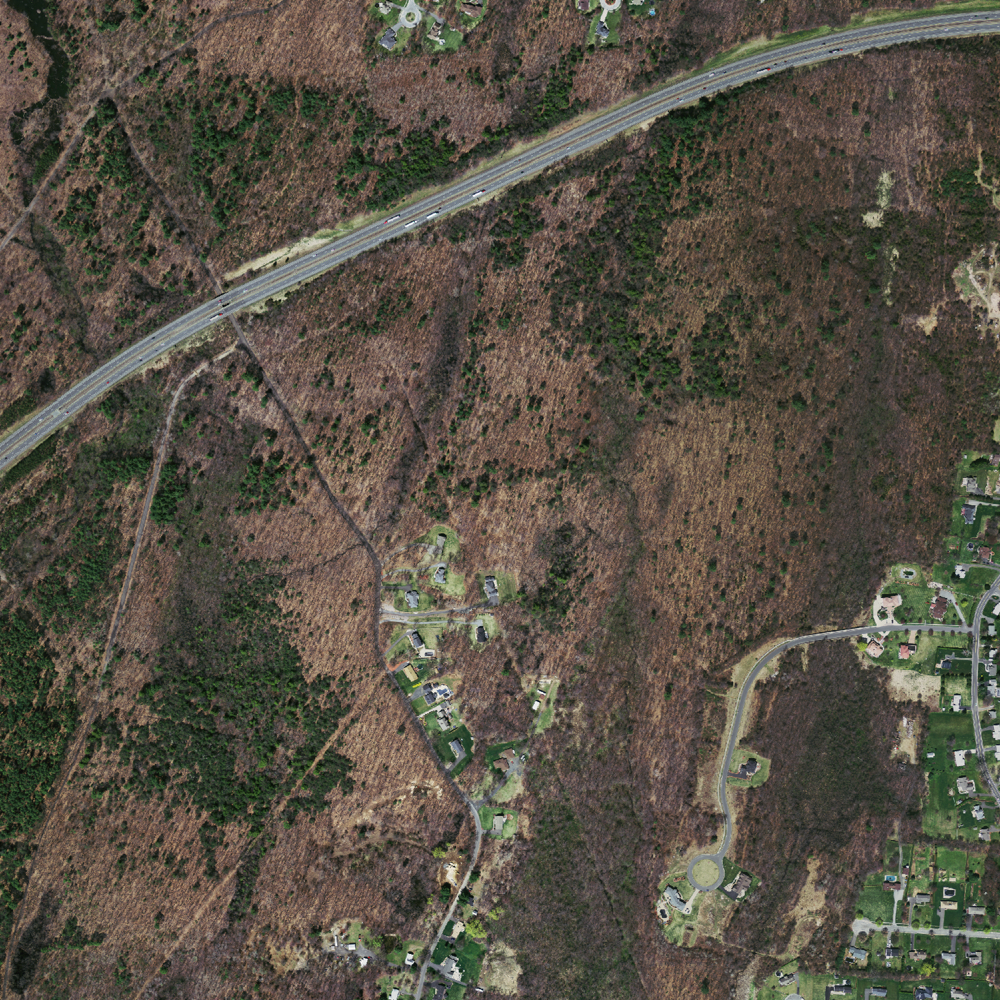

In [3]:


import matplotlib.pyplot as plt
from skimage import io
from skimage.filters.rank import entropy
from skimage.morphology import disk
from pathlib import Path
from IPython.display import display
from PIL import Image
from skimage.color import convert_colorspace
img = Image.open("./data/tiff/test/10378780_15.tiff")
display(img)
test_imgs = [
    "./data/tiff/test/10378780_15.tiff",
    "./data/tiff/test/10828720_15.tiff" ,
    "./data/tiff/test/11128870_15.tiff" ,
    "./data/tiff/test/11278840_15.tiff" ,
    "./data/tiff/test/11728825_15.tiff" ,
    "./data/tiff/test/12328750_15.tiff" ,
    "./data/tiff/test/15928855_15.tiff" ,
    "./data/tiff/test/16078870_15.tiff" ,
    "./data/tiff/test/17878735_15.tiff" ,
    "./data/tiff/test/17878780_15.tiff" ,
    "./data/tiff/test/17878885_15.tiff" ,
    "./data/tiff/test/18028750_15.tiff" ,
    "./data/tiff/test/18178780_15.tiff" ,
    "./data/tiff/test/18328735_15.tiff" ,
    "./data/tiff/test/18328780_15.tiff" ,
    "./data/tiff/test/18328960_15.tiff" ,
    "./data/tiff/test/18478735_15.tiff" ,
    "./data/tiff/test/18478900_15.tiff",
]
expected_outputs = [
"./data/tiff/test_labels/10378780_15.tif",
"./data/tiff/test_labels/10828720_15.tif",
"./data/tiff/test_labels/11128870_15.tif",
"./data/tiff/test_labels/11278840_15.tif",
"./data/tiff/test_labels/11728825_15.tif",
"./data/tiff/test_labels/12328750_15.tif",
"./data/tiff/test_labels/15928855_15.tif",
"./data/tiff/test_labels/16078870_15.tif",
"./data/tiff/test_labels/17878735_15.tif",
"./data/tiff/test_labels/17878780_15.tif",
"./data/tiff/test_labels/17878885_15.tif",
"./data/tiff/test_labels/18028750_15.tif",
"./data/tiff/test_labels/18178780_15.tif",
"./data/tiff/test_labels/18328735_15.tif",
"./data/tiff/test_labels/18328780_15.tif",
"./data/tiff/test_labels/18328960_15.tif",
"./data/tiff/test_labels/18478735_15.tif",
"./data/tiff/test_labels/18478900_15.tif"
]
img = io.imread("./data/tiff/test/10378780_15.tiff", as_gray=True)
img_color = io.imread("./data/tiff/test/10378780_15.tiff")



/Users/bartlomiejstefanko/CODE/STUDIA/projekty/analiza_danych_multimedialnych/Analiza-danych-multimedialnych/.venv/lib/python3.14/site-packages/IPython/core/interactiveshell.py:3699: UserWarning: Possible precision loss converting image of type float64 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  exec(code_obj, self.user_global_ns, self.user_ns)


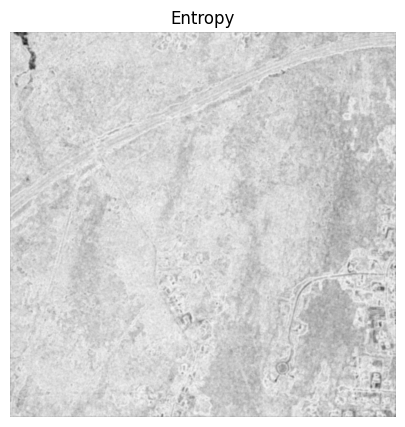

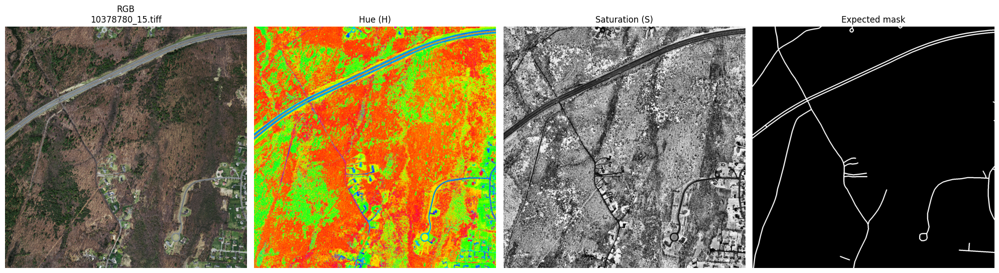

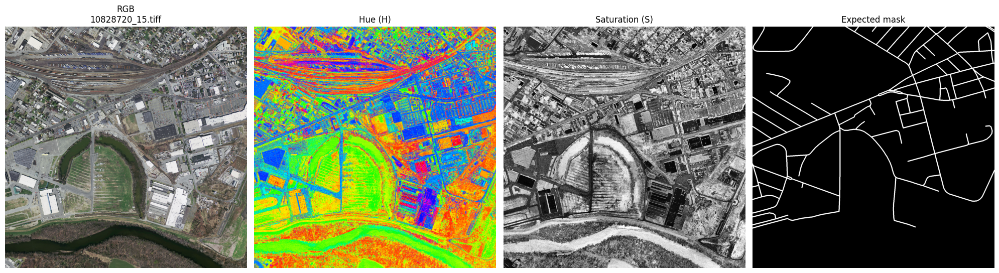

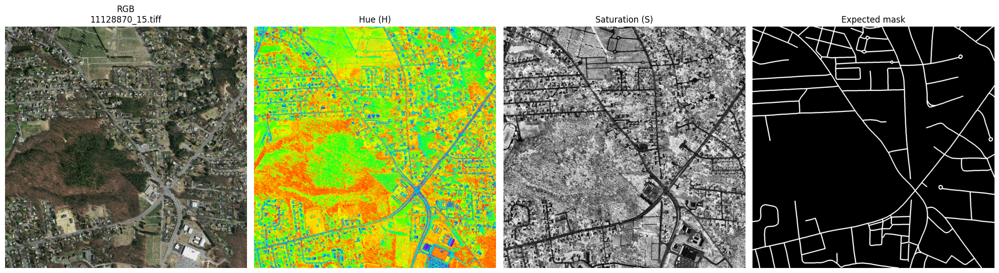

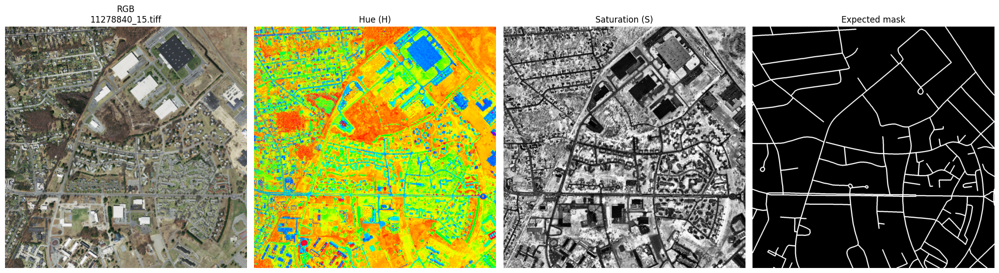

...

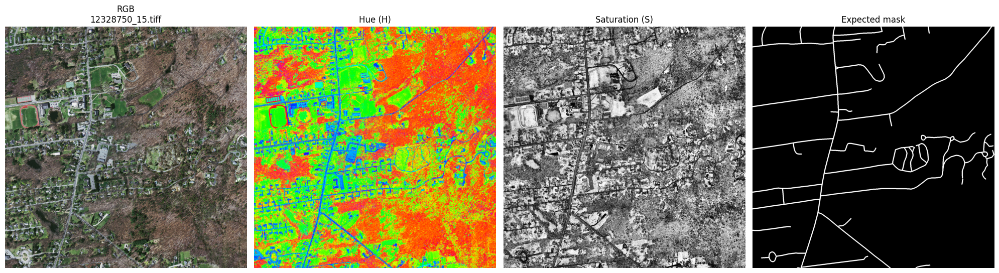

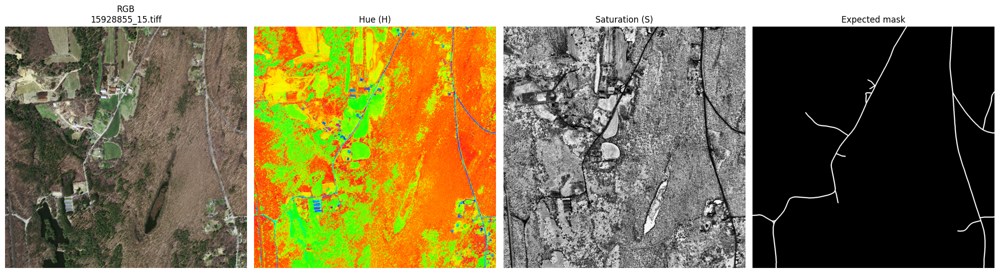

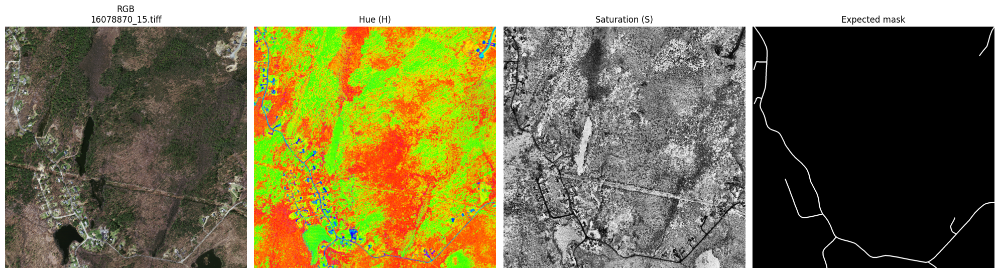

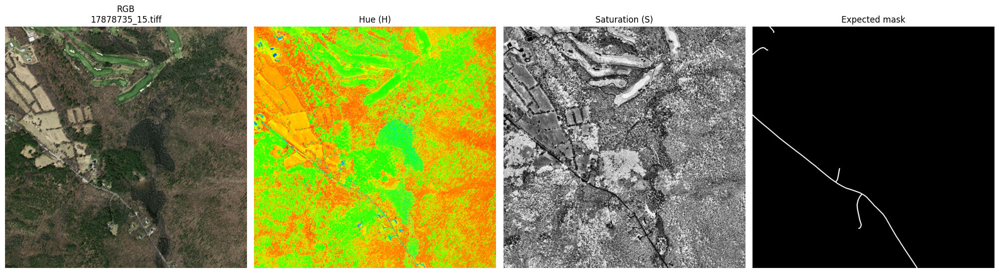

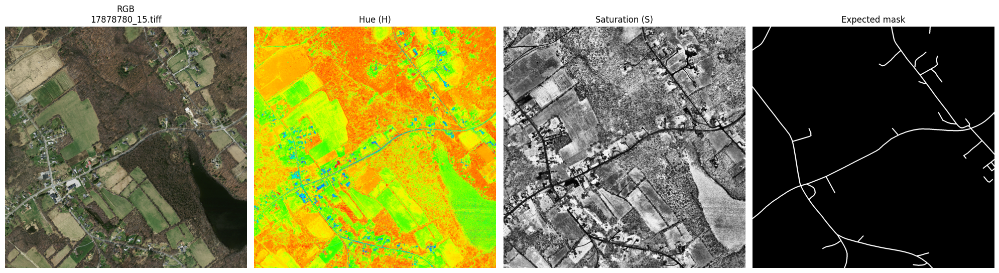

In [ ]:
from skimage.color import rgb2hsv
from skimage import io
import matplotlib.pyplot as plt
from pathlib import Path
from skimage import exposure
from skimage import exposure

entropy_img = entropy(img, disk(5))
plt.figure(figsize=(10, 5))
plt.title('Entropy')
plt.imshow(entropy_img, cmap='gray')
plt.axis('off')
plt.show()


for idx, path in enumerate(test_imgs[:10]):
    img_color = io.imread(path)
    hsv = rgb2hsv(img_color)
    h, s, v = hsv[...,0], hsv[...,1], hsv[...,2]

    expected_output = io.imread(expected_outputs[idx])
    s_boost = exposure.rescale_intensity(s, in_range='image', out_range=(0, 1))
    s_gamma = exposure.equalize_adapthist(s, clip_limit=0.03)

    plt.figure(figsize=(20,8))

    plt.subplot(1,4,1)
    plt.title(f'RGB\n{Path(path).name}')
    plt.imshow(img_color)
    plt.axis('off')

    plt.subplot(1,4,2)
    plt.title('Hue (H)')
    plt.imshow(h, cmap='hsv')
    plt.axis('off')

    plt.subplot(1,4,3)
    plt.title('Saturation (S)')
    plt.imshow(s_gamma, cmap='gray')
    plt.axis('off')

    plt.subplot(1,4,4)
    plt.title('Expected mask')
    plt.imshow(expected_output, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()




In [ ]:
# Hinty
# https://scikit-image.org/docs/stable/auto_examples/edges/plot_ridge_filter.html
# local binnary patterns
# grayc level co-occurrence matrix
